In [34]:
import pandas as pd
import numpy as np
from sklearn.metrics import accuracy_score, mean_squared_error
from sklearn.model_selection import train_test_split
import warnings

warnings.filterwarnings('ignore')


#features 
features_file = '/home/mat/eeg_epilepsy/filtered_demo_epilepsy.csv'
# participant_file='/home/mat/projects/def-kjerbi/cocolab_data/EEG_ADHD_epilepsy_psychostimulants/BIDS/participants.tsv'
# Read CSV into a DataFrame
features = pd.read_csv(features_file)

features_ending_with_C3 = {col[:-2] for col in features.columns if col.endswith('C3')}

# Remove 'A1' from each column name and create a new list
feature_names = list(features_ending_with_C3)

print("number of features:", len(feature_names), "names: ", feature_names)
suffixes_set = {col[-2:] for col in features.columns if col.startswith("feature-BandRatiosFromAverageFooof.bands_pairs-('alpha', 'beta').spaces-")}

# Convert to list (optional - sets are unordered)
sensor_names = list(suffixes_set)
print("#sensors: ", len(sensor_names), "sensor names: ", sensor_names)


number of features: 67 names:  ["feature-BandRatiosFromAverageFooof.bands_pairs-('alpha', 'gamma').spaces-", "feature-BandRatiosFromAverageFooof.bands_pairs-('alpha', 'beta').spaces-", 'feature-spectralEntropyMeanEpochs.spaces-', 'feature-svdEntropyMeanEpochs.spaces-', "feature-BandRatiosFromAverageFooof.bands_pairs-('theta', 'gamma').spaces-", "feature-BandRatiosFromAverageSpectrum.bands_pairs-('gamma', 'theta').spaces-", 'feature-appEntropyMeanEpochs.spaces-', 'feature-RelativeBandPowerFromAverageSpectrum.bands-delta.spaces-', "feature-BandRatiosFromAverageSpectrum.bands_pairs-('delta', 'alpha').spaces-", "feature-BandRatiosFromAverageSpectrum.bands_pairs-('gamma', 'alpha').spaces-", "feature-BandRatiosFromAverageFooof.bands_pairs-('gamma', 'theta').spaces-", 'feature-RelativeBandPowerFromAverageFooof.bands-gamma.spaces-', "feature-BandRatiosFromAverageFooof.bands_pairs-('delta', 'alpha').spaces-", 'feature-RelativeBandPowerFromAverageFooof.bands-beta.spaces-', "feature-BandRatiosFro

1. random forests without filtering:

In [9]:
from sklearn.ensemble import RandomForestClassifier

X = features
X = X.replace([np.inf, -np.inf], np.nan)

# Drop rows with NaN
X = X.dropna()
# Clip extreme values to safe range for float32
X = X.clip(lower=-1e30, upper=1e30) 
y = X["Epilepsy"]
X = X.drop(columns =["Epilepsy"])
y = y.replace('0 (potentiel)', '0')

# Fit Random Forest
model = RandomForestClassifier()
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
model.fit(X_train, y_train)

# predictions: 
y_pred = model.predict(X_test)
print("Test Accuracy:", accuracy_score(y_test, y_pred))
mse = mean_squared_error(y_test, y_pred)
print("MSE:", mean_squared_error(y_test, y_pred))


#feature importance 

feature_importances = model.feature_importances_
feature_names = X.columns
importance_df = pd.DataFrame({
    'feature': feature_names,
    'importance': feature_importances
}).sort_values(by='importance', ascending=False)
importance_df.to_csv('RF_feature_importance.csv', index=False)


Test Accuracy: 0.6923076923076923
MSE: 0.3076923076923077


2. random forest by feature

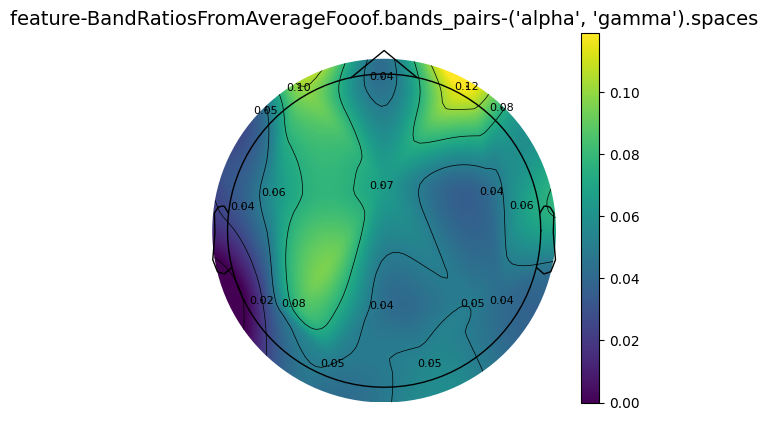

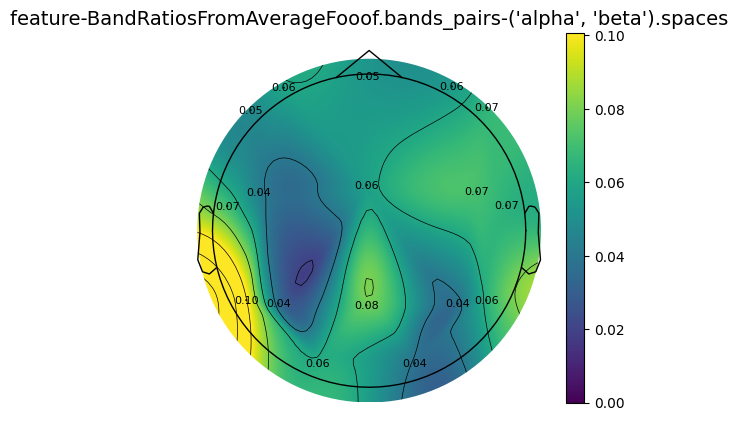

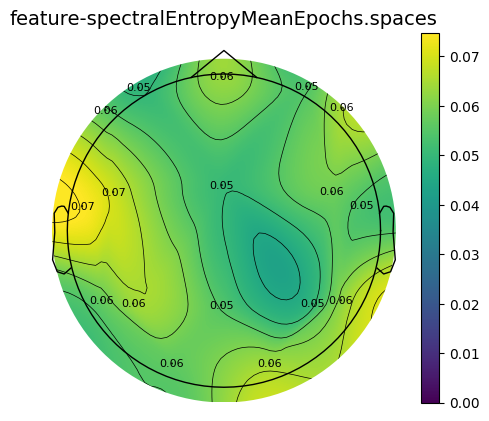

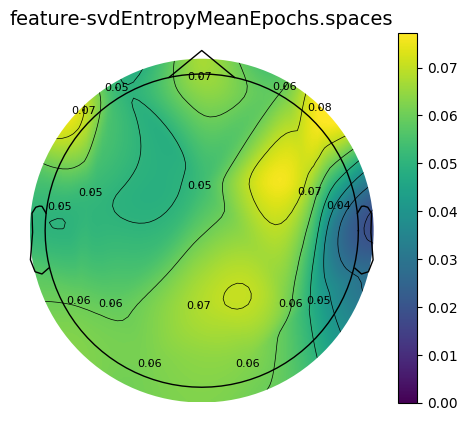

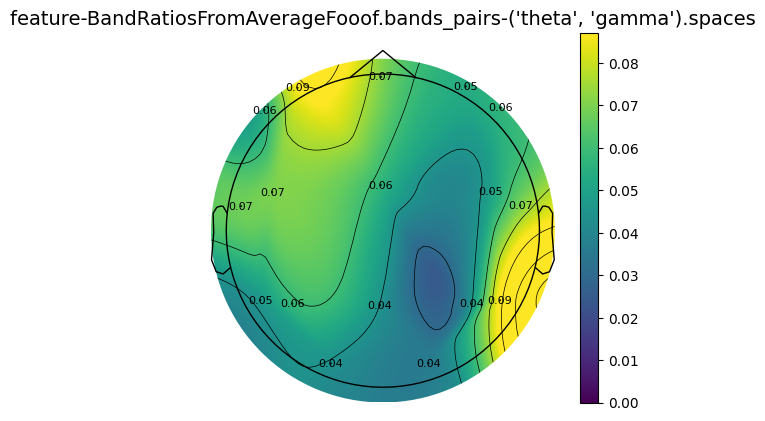

...

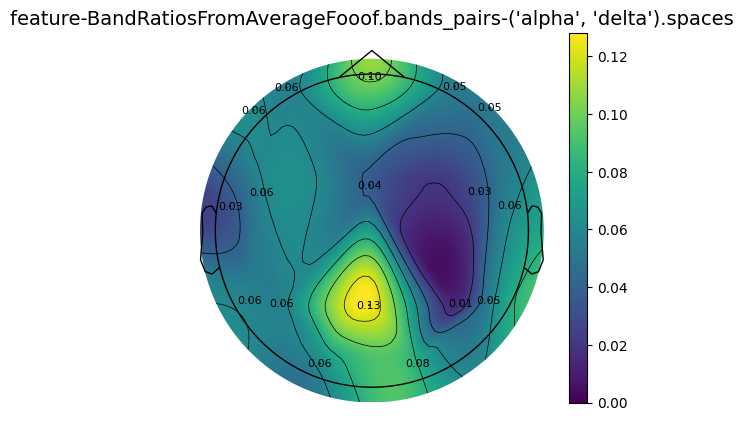

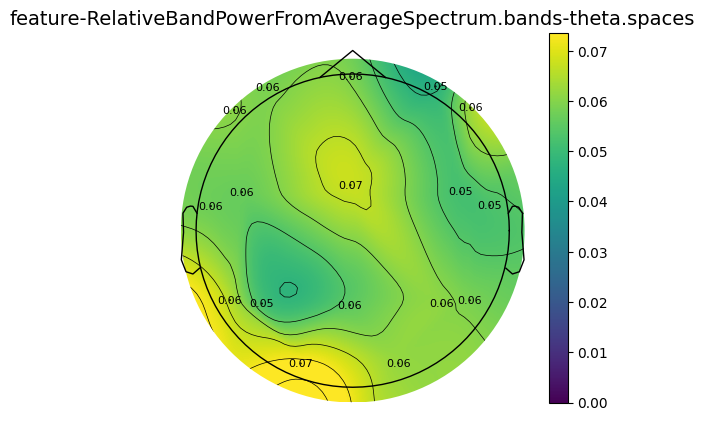

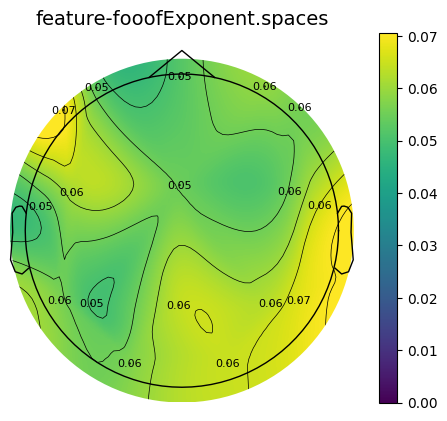

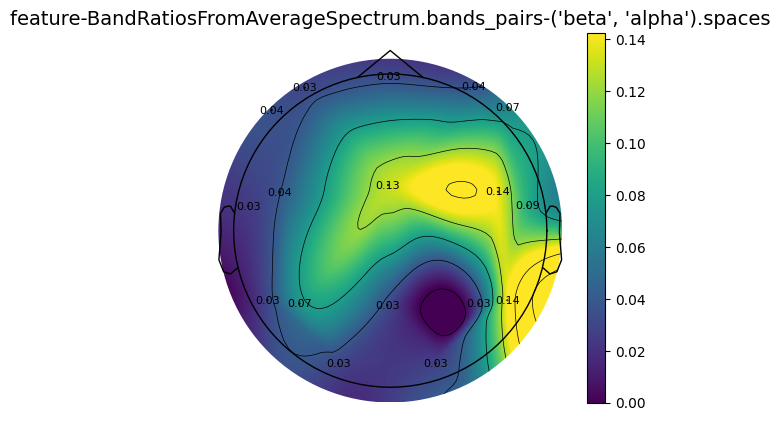

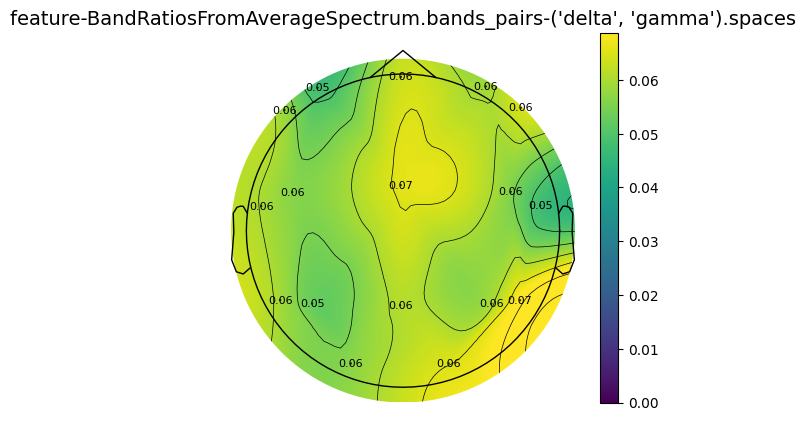

In [61]:
from sklearn.metrics import accuracy_score, mean_squared_error
import mne
from matplotlib import pyplot as plt
from mne.channels import make_standard_montage  
from mne.viz import plot_topomap  
from sklearn.ensemble import RandomForestClassifier



results_df = pd.DataFrame(columns=['feature_name', 'importance', 
                                 'accuracy', 'mse'])

for name in feature_names:
    X = features.loc[:, features.columns.str.startswith(name) | (features.columns == "Epilepsy")]
    X.replace([np.inf, -np.inf], np.nan, inplace=True)
    X = X.clip(lower=-1e30, upper=1e30) 
    X = X.dropna()
    y = X["Epilepsy"]
    # p2, p1 dont exist int the montage couldn't match them. 
    columns_to_drop = [col for col in X.columns if col.endswith(('p2', 'p1','.1'))]
    X = X.drop(columns = columns_to_drop)  
    X = X.drop(columns =["Epilepsy"])  
    X.columns = [col[-2:] for col in X.columns]

    y = y.replace('0 (potentiel)', '0')
    model = RandomForestClassifier()
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    model.fit(X_train, y_train)

    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)

    sensor_names = [col for col in X.columns]   
    importance = model.feature_importances_
    results_df.loc[len(results_df)] = {
    'feature_name': name,
    'importance': importance,
    'accuracy': accuracy,
    'mse': mse
}

    if not np.all(importance == 0):

        data = importance[:, np.newaxis]
        info = mne.create_info(ch_names=sensor_names, sfreq=250.0, ch_types='eeg')
        montage = make_standard_montage('standard_1020')
        info.set_montage(montage)
        pos = mne.find_layout(info).pos  
        ch_pos = {ch: info['chs'][i]['loc'][:2] for i, ch in enumerate(info['ch_names'])}


        # Create pos array (x, y) coordinates
        pos_2d = np.array([ch_pos[ch] for ch in sensor_names])

        # Plot the topomap
        fig, ax = plt.subplots()
        im, _ = plot_topomap(
        data=importance,
        pos=pos_2d,
        axes=ax,
        cmap='viridis',
        show=False,
        vlim=(0, np.max(importance))
    )

        # Add coefficient value annotations
        for (x, y), val in zip(pos_2d, importance):
            if val != 0:
                ax.text(x, y, f"{val:.2f}", ha='center', va='center', fontsize=8, color='black')

        ax.set_title(name[:-1], fontsize=14)
        plt.colorbar(im, ax=ax)
        plt.show()

# print(len(zero_coeff))
# print(zero_coeff)
results_df.to_csv('rf_per_feature.csv', index=False)

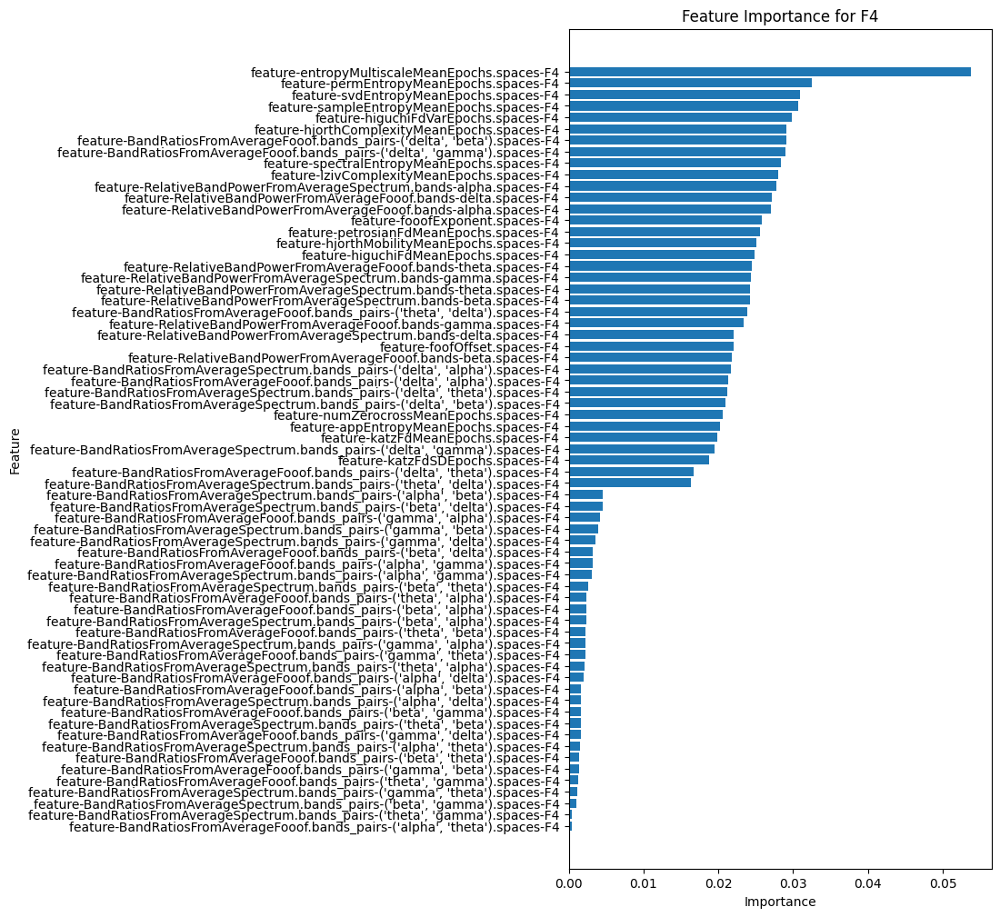

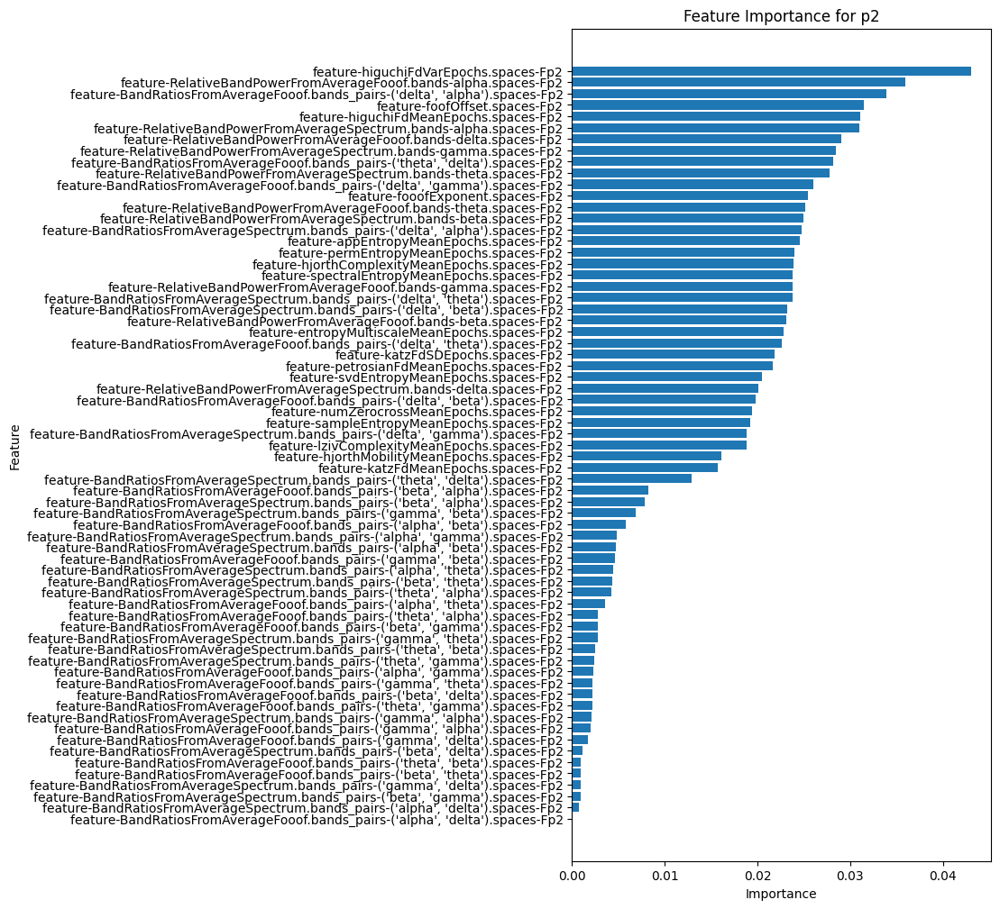

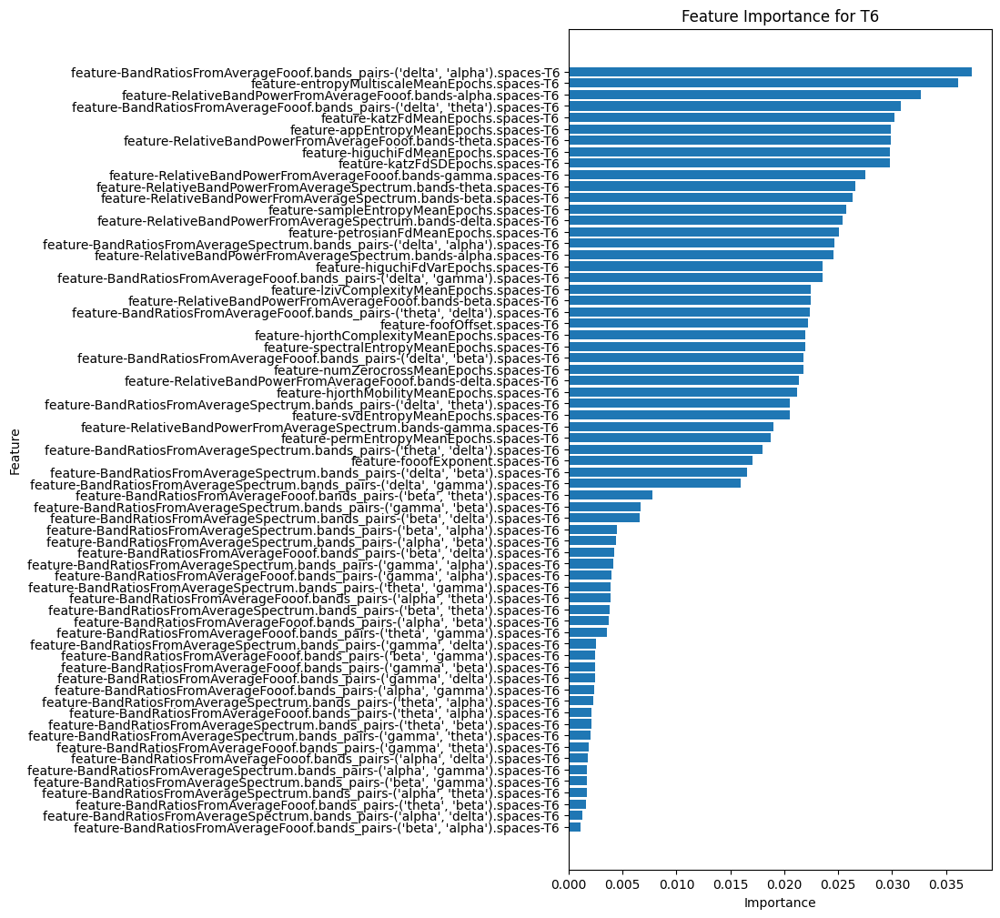

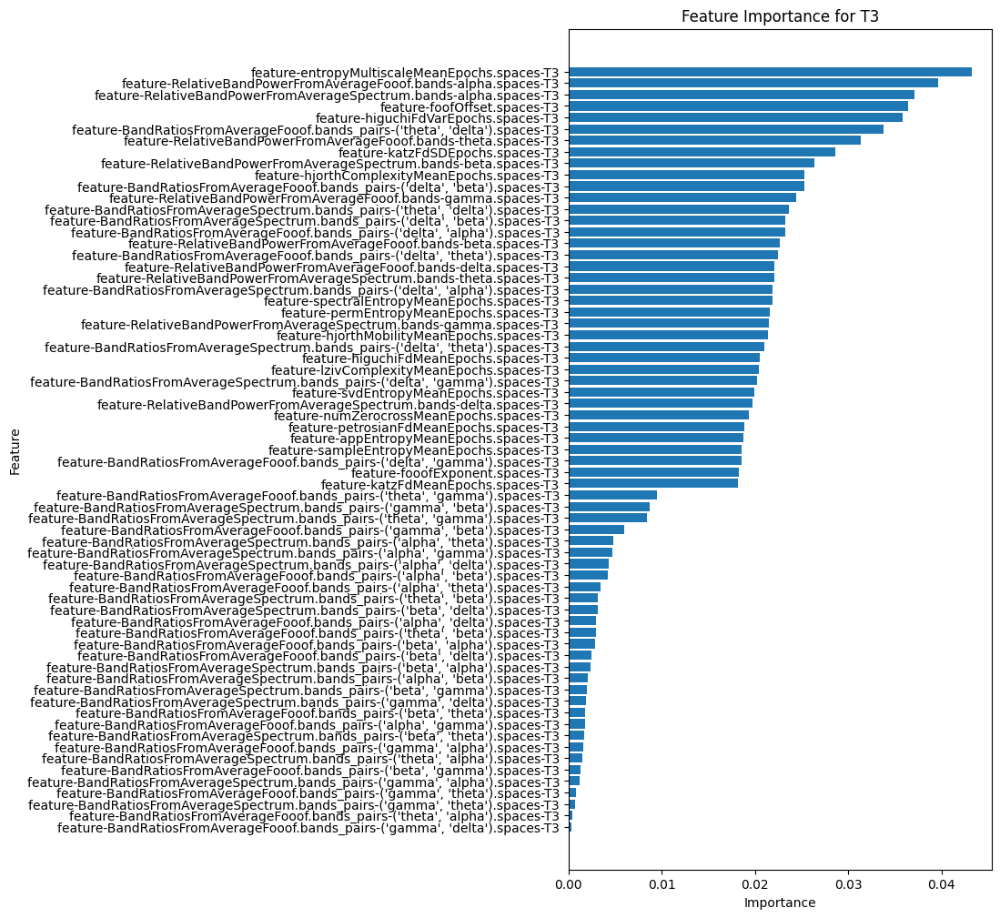

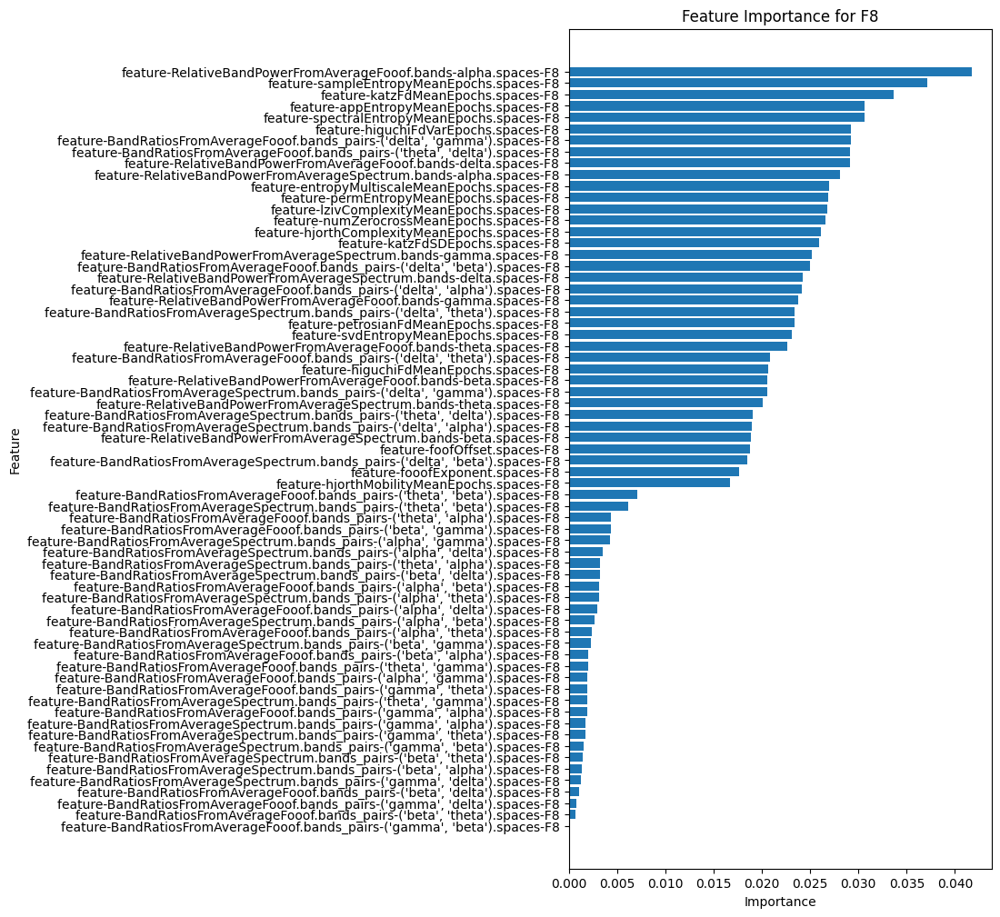

...

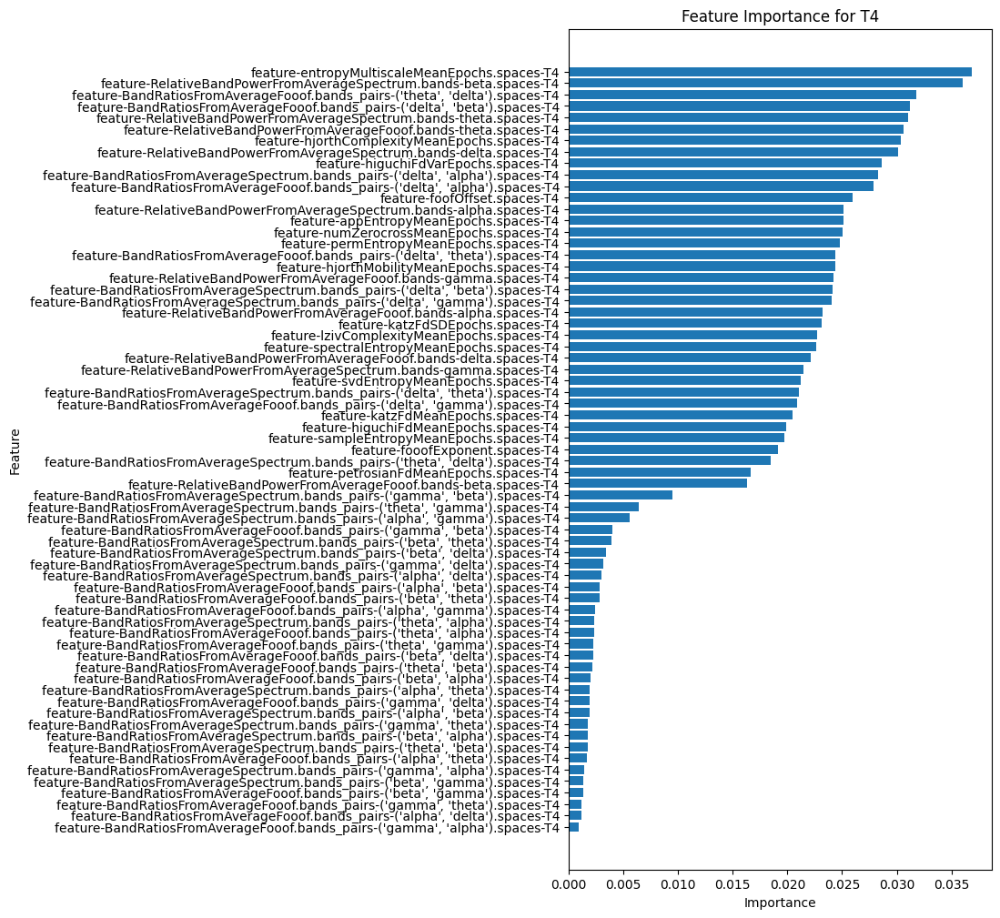

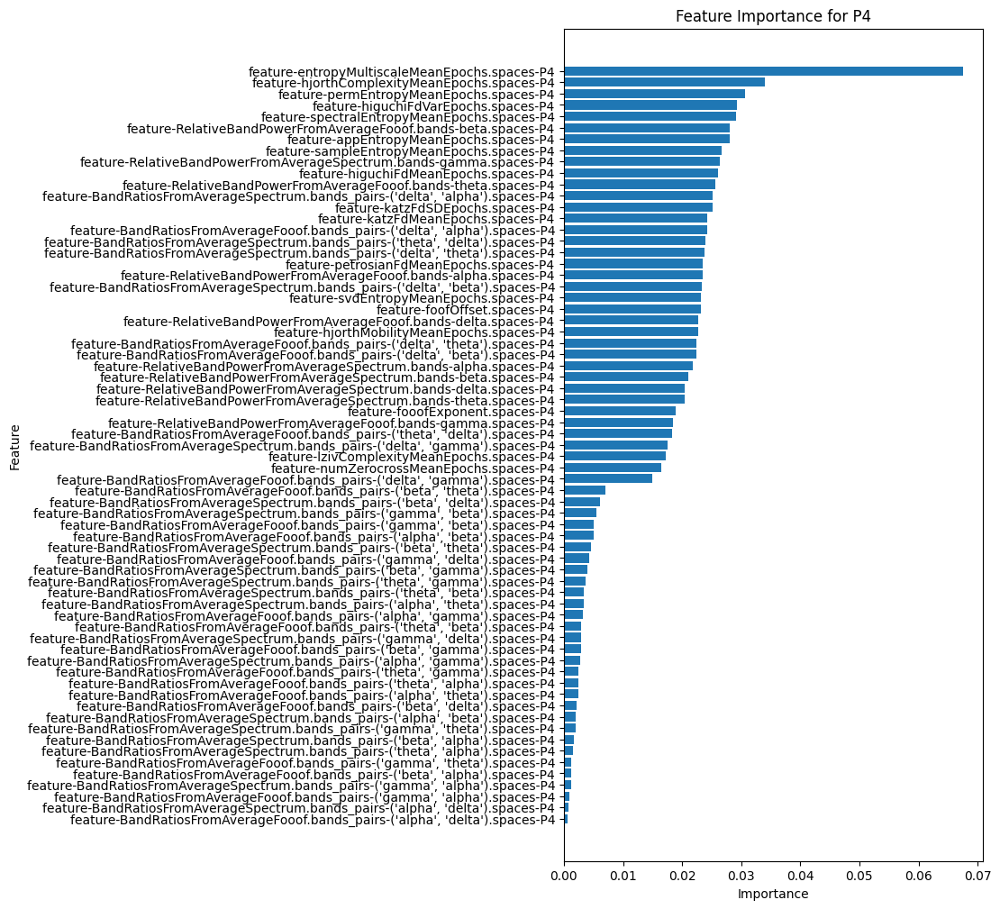

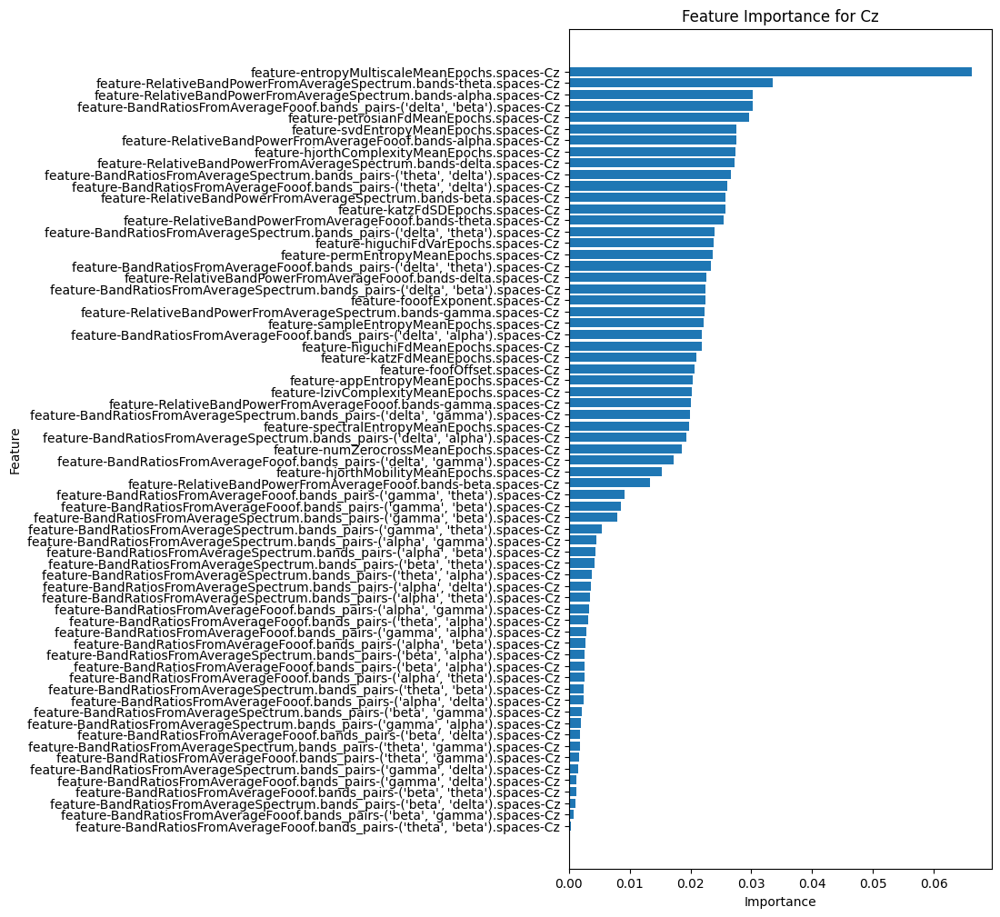

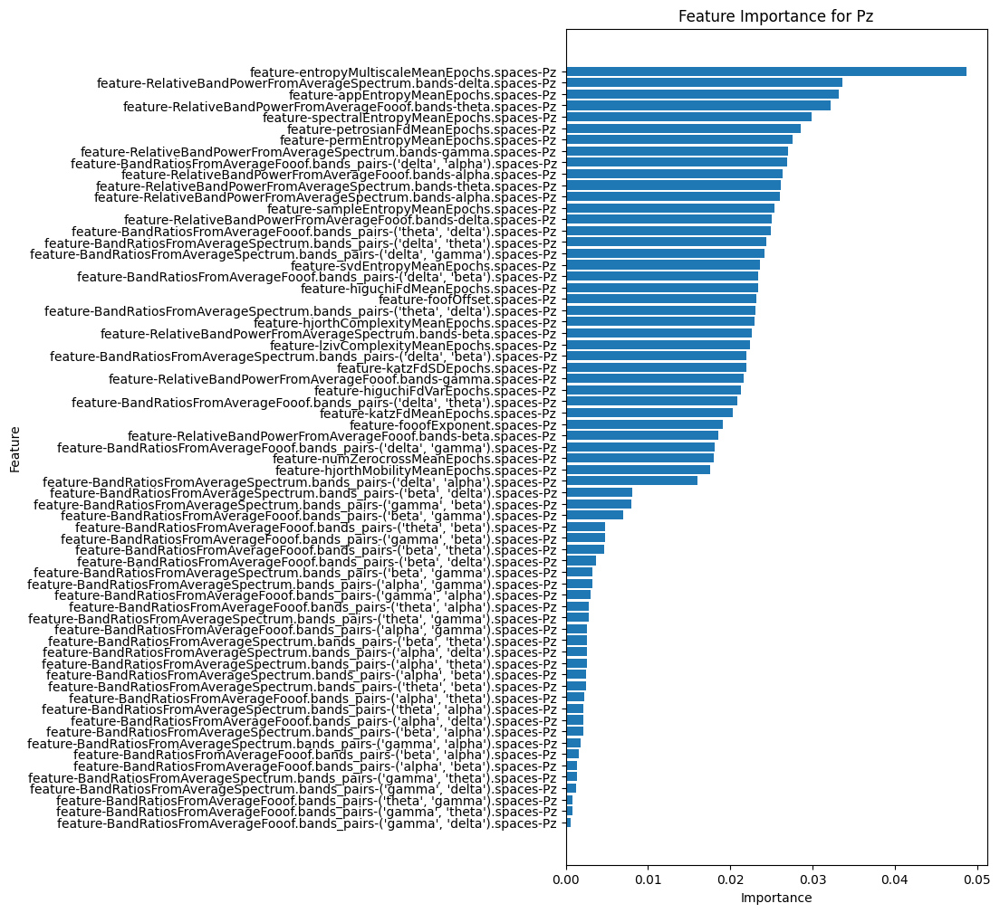

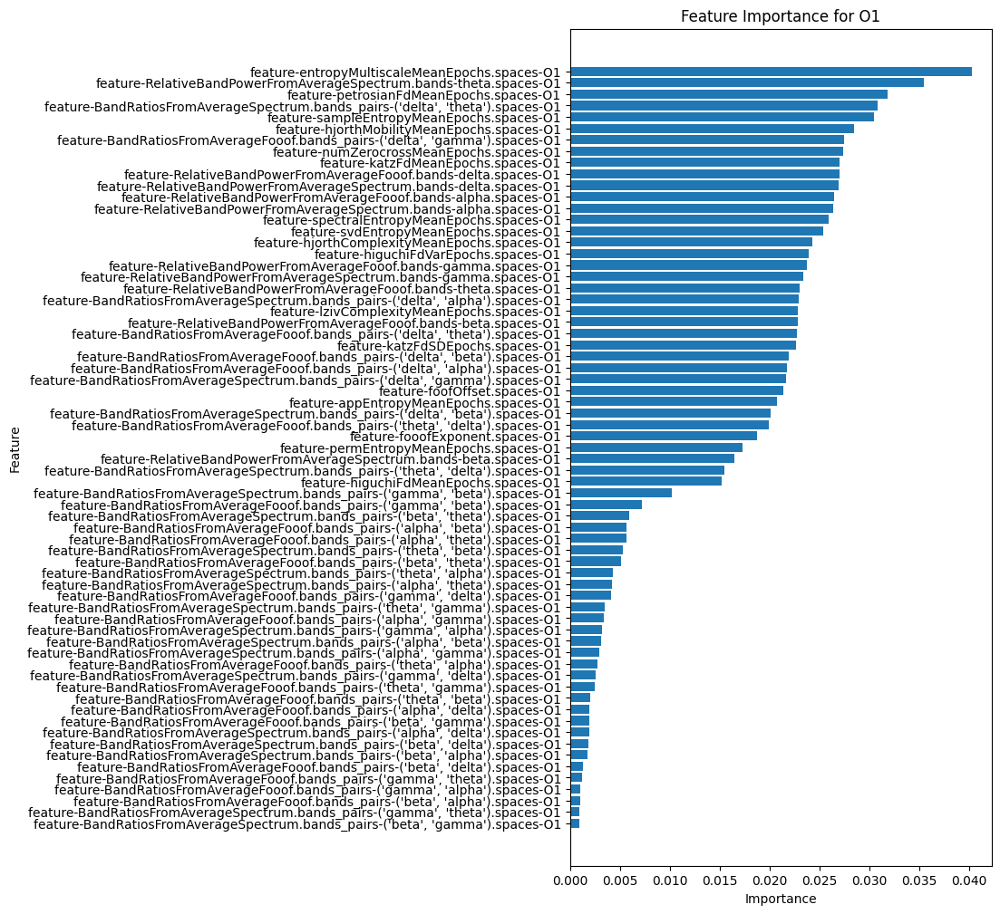

In [60]:
sensors_df = pd.DataFrame(columns=['sensor_name', 'importance', 'accuracy', 'mse'])
sensor_names = list(suffixes_set)

for sensor in sensor_names:
    X = features.loc[:, features.columns.str.endswith(sensor) | (features.columns == "Epilepsy")]
    X.replace([np.inf, -np.inf], np.nan, inplace=True)
    X = X.clip(lower=-1e30, upper=1e30) 
    X = X.dropna()
    y = X["Epilepsy"]
    X = X.drop(columns =["Epilepsy"])  
    y = y.replace('0 (potentiel)', '0')
    model = RandomForestClassifier()
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    model.fit(X_train, y_train)

    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)

    importance = model.feature_importances_
    sensors_df.loc[len(sensors_df)] = {
    
    'sensor_name': sensor,
    'importance': importance,
    'accuracy': accuracy,
    'mse': mse
}
    feat_df = pd.DataFrame({
        'feature': X.columns,
        'importance': importance
    }).sort_values(by='importance', ascending=True)

    # Plot
    plt.figure(figsize=(6, 12))
    plt.barh(feat_df['feature'], feat_df['importance'])
    plt.title(f"Feature Importance for {sensor}")
    plt.xlabel("Importance")
    plt.ylabel("Feature")
    plt.tight_layout()
    plt.show()
sensors_df.to_csv('rf_per_sensor.csv', index=False)
